# Exploratory Data Analysis para datos de Temperatura


## Importando librerías y variables de entorno


In [56]:
import pandas as pd
from azure.data.tables import TableClient
import os
from dotenv import load_dotenv, find_dotenv
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
load_dotenv(find_dotenv())

True

In [3]:
connection_string = os.getenv("AZ_CONNECTION_STRING")

## Leyendo Datos


In [4]:
## Definiendo funciones:


# Crear conexión de una tabla específica dentro del servicio de Azure Table Storage
def set_table_service(connection_string, table):
    """Crear servicio de conexión a Azure Table Storage"""
    return TableClient.from_connection_string(
        conn_str=connection_string, table_name=table
    )


# Obtener datos de Table Storage
def get_data_from_table_storage_table(table_service, filter_query):
    """Recuperar datos de Table Storage"""
    for record in table_service.query_entities(filter_query):
        yield record


# Crear DataFrame con los datos de la tabla consultada
def get_dataframe_from_table_storage_table(table_service, filter_query):
    """Crear un DataFrame con la data del Table Storage"""
    return pd.DataFrame(get_data_from_table_storage_table(table_service, filter_query))

In [5]:
table_name_trm = "TEMPERATURACurated"
filterQuery = "PartitionKey ne 'random'"

In [6]:
# Creando DataFrame con Temperatura Data
table_service_temperatura = set_table_service(connection_string, table_name_trm)
df_temperatura = get_dataframe_from_table_storage_table(
    table_service_temperatura, filterQuery
)

print(f"Shape: {df_temperatura.shape}")
print(f"dtypes: {df_temperatura.dtypes}")
df_temperatura.head()

Shape: (182761, 16)
dtypes: PartitionKey          object
RowKey                object
TimeStamp              int64
codigoestacion        object
codigosensor          object
date                  object
departamento          object
descripcionsensor     object
latitud               object
longitud              object
municipio             object
nombreestacion        object
temp_max             float64
temp_min             float64
unidadmedida          object
zonahidrografica      object
dtype: object


,PartitionKey,RowKey,TimeStamp,codigoestacion,codigosensor,date,departamento,descripcionsensor,latitud,longitud,municipio,nombreestacion,temp_max,temp_min,unidadmedida,zonahidrografica
0,DefaultPartitionKey,00004632-074c-49c5-ada2-0d80acc76753,20231103,0023025502,0068,2023-02-13T00:00:00.000,CALDAS,Temp Aire 2 m,5.044997222,-75.33221944,MANIZALES,ALMACAFE LETRAS - AUT,11.76996,3.194234,°C,MEDIO MAGDALENA
1,DefaultPartitionKey,00006165-52f2-4ddb-86bc-928e0e7d5270,20231104,0024025050,0068,2021-02-16T00:00:00.000,SANTANDER,Temp Aire 2 m,6.274,-73.151,CHARALÁ,CHARALA - ISAGEN - Estacion en Pruebas,28.70000,16.900000,°C,SOGAMOSO
2,DefaultPartitionKey,0000c881-f422-45e6-b3a7-d80ed727431b,20231104,0016025503,0068,2022-08-03T00:00:00.000,NORTE DE SANTANDER,Temp Aire 2 m,7.923163889,-72.83375556,GRAMALOTE,GRAMALOTE - AUT,22.89349,15.377090,°C,CATATUMBO
3,DefaultPartitionKey,0000f7fd-1700-4e21-aacf-884faf159ef5,20231104,0026125502,0068,2022-07-23T00:00:00.000,VALLE DEL CAUCA,Temp Aire 2 m,4.297558333,-75.86396111,CAICEDONIA,CAICEDONIA - AUT,25.46039,17.622430,°C,CAUCA
4,DefaultPartitionKey,0001598f-192a-4d55-bf47-fda975ba6f14,20231104,0035080050,0068,2022-04-04T00:00:00.000,BOYACÁ,Temp Aire 2 m,5.096,-73.053,PÁEZ,PAEZ,23.45000,17.940000,°C,META


## Preprocesando los datos


### Conservando y Transformado Columnas Relevantes


In [7]:
df_temperatura.columns

Index(['PartitionKey', 'RowKey', 'TimeStamp', 'codigoestacion', 'codigosensor',
       'date', 'departamento', 'descripcionsensor', 'latitud', 'longitud',
       'municipio', 'nombreestacion', 'temp_max', 'temp_min', 'unidadmedida',
       'zonahidrografica'],
      dtype='object')

In [12]:
columns_to_keep = [
    "date",
    "departamento",
    "municipio",
    "latitud",
    "longitud",
    "temp_max",
    "temp_min",
]

df_temperatura = df_temperatura[columns_to_keep]
df_temperatura.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min
0,2023-02-13T00:00:00.000,CALDAS,MANIZALES,5.044997222,-75.33221944,11.76996,3.194234
1,2021-02-16T00:00:00.000,SANTANDER,CHARALÁ,6.274,-73.151,28.70000,16.900000
2,2022-08-03T00:00:00.000,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,22.89349,15.377090
3,2022-07-23T00:00:00.000,VALLE DEL CAUCA,CAICEDONIA,4.297558333,-75.86396111,25.46039,17.622430
4,2022-04-04T00:00:00.000,BOYACÁ,PÁEZ,5.096,-73.053,23.45000,17.940000


In [13]:
# formateando columna date
df_temperatura[df_temperatura["date"].str.contains("T") == False]

,date,departamento,municipio,latitud,longitud,temp_max,temp_min


Todas las fechas tienen el formato "YYYY-MM-DDTHH:mm:ss:mss" por lo que se debe transformar para conservar solo la fecha sin horas


In [19]:
df_temperatura["date"].apply(lambda x: x.split("T")[0])

0         2023-02-13
1         2021-02-16
2         2022-08-03
3         2022-07-23
4         2022-04-04
             ...    
182756    2022-09-13
182757    2022-10-28
182758    2021-04-12
182759    2021-02-01
182760    2022-01-23
Name: date, Length: 182761, dtype: object

In [21]:
df_temperatura["date"] = df_temperatura["date"].apply(lambda x: x.split("T")[0])
df_temperatura.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min
0,2023-02-13,CALDAS,MANIZALES,5.044997222,-75.33221944,11.76996,3.194234
1,2021-02-16,SANTANDER,CHARALÁ,6.274,-73.151,28.70000,16.900000
2,2022-08-03,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,22.89349,15.377090
3,2022-07-23,VALLE DEL CAUCA,CAICEDONIA,4.297558333,-75.86396111,25.46039,17.622430
4,2022-04-04,BOYACÁ,PÁEZ,5.096,-73.053,23.45000,17.940000


### Formateando tipo de datos


In [23]:
df_temperatura["date"] = pd.to_datetime(df_temperatura["date"])
df_temperatura.dtypes

date            datetime64[ns]
departamento            object
municipio               object
latitud                 object
longitud                object
temp_max               float64
temp_min               float64
dtype: object

### Formateando nombre de departamentos


In [40]:
print(len(df_temperatura.sort_values(by="departamento").departamento.unique()))
df_temperatura.sort_values(by="departamento").departamento.unique()

34


array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
       'ATLANTICO', 'BOGOTA', 'BOLIVAR', 'BOYACA', 'CALDAS', 'CAQUETA',
       'CASANARE', 'CAUCA', 'CESAR', 'CHOCO', 'CORDOBA', 'CUNDINAMARCA',
       'GUAINIA', 'GUAVIARE', 'HUILA', 'LA GUAJIRA', 'MAGDALENA', 'META',
       'NARINO', 'NARIÑO', 'NORTE DE SANTANDER', 'PUTUMAYO', 'QUINDIO',
       'RISARALDA', 'SAN ANDRES PROVIDENCIA', 'SANTANDER', 'SUCRE',
       'TOLIMA', 'VALLE DEL CAUCA', 'VICHADA'], dtype=object)

Se identifican departamentos duplicados por errores en su escritura. Para solucionar esto, se van a eliminar tildes y la palabra "D.C".


In [35]:
dict_to_replace_dpto = {"Á": "A", "É": "E", "Í": "I", "Ó": "O", "Ú": "U", "D.C": ""}

# Apply the replacement using the dictionary
for letter, replacement in dict_to_replace_dpto.items():
    df_temperatura["departamento"] = df_temperatura["departamento"].apply(
        lambda x: x.replace(letter, replacement)
    )


df_temperatura.sort_values(by="departamento").departamento.unique()

array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
       'ARCHIPIELAGO DE SAN ANDRES, PROVIDENCIA Y SANTA CATALINA',
       'ATLANTICO', 'BOGOTA', 'BOGOTA .', 'BOLIVAR', 'BOYACA', 'CALDAS',
       'CAQUETA', 'CASANARE', 'CAUCA', 'CESAR', 'CHOCO', 'CORDOBA',
       'CUNDINAMARCA', 'GUAINIA', 'GUAVIARE', 'HUILA', 'LA GUAJIRA',
       'MAGDALENA', 'META', 'NARINO', 'NARIÑO', 'NORTE DE SANTANDER',
       'PUTUMAYO', 'QUINDIO', 'RISARALDA', 'SAN ANDRES PROVIDENCIA',
       'SANTANDER', 'SUCRE', 'TOLIMA', 'VALLE DEL CAUCA', 'VICHADA'],
      dtype=object)

Finalmente, se borra los caracteres ",", "." y se quitan los espacios al final del texto.


In [41]:
df_temperatura["departamento"] = df_temperatura["departamento"].apply(
    lambda x: x.replace(".", "")
)
df_temperatura["departamento"] = df_temperatura["departamento"].apply(
    lambda x: x.replace(",", "")
)
df_temperatura["departamento"] = df_temperatura["departamento"].str.strip()

print(len(df_temperatura.sort_values(by="departamento").departamento.unique()))
df_temperatura.sort_values(by="departamento").departamento.unique()

34


array(['AMAZONAS', 'ANTIOQUIA', 'ARAUCA',
       'ARCHIPIELAGO DE SAN ANDRES PROVIDENCIA Y SANTA CATALINA',
       'ATLANTICO', 'BOGOTA', 'BOLIVAR', 'BOYACA', 'CALDAS', 'CAQUETA',
       'CASANARE', 'CAUCA', 'CESAR', 'CHOCO', 'CORDOBA', 'CUNDINAMARCA',
       'GUAINIA', 'GUAVIARE', 'HUILA', 'LA GUAJIRA', 'MAGDALENA', 'META',
       'NARINO', 'NARIÑO', 'NORTE DE SANTANDER', 'PUTUMAYO', 'QUINDIO',
       'RISARALDA', 'SAN ANDRES PROVIDENCIA', 'SANTANDER', 'SUCRE',
       'TOLIMA', 'VALLE DEL CAUCA', 'VICHADA'], dtype=object)

### Formateando nombre de municipios


In [39]:
print(len(df_temperatura.sort_values(by="municipio").municipio.unique()))
df_temperatura.sort_values(by="municipio").municipio.unique()

331


array(['ABRIAQUÍ', 'ACANDÍ', 'ACEVEDO', 'ACHÍ', 'AGRADO', 'AGUACHICA',
       'AGUSTÍN CODAZZI', 'AIPE', 'ALBANIA', 'ALCALÁ', 'ALDANA',
       'ALGECIRAS', 'ALPUJARRA', 'ALTAMIRA', 'AMBALEMA', 'ANAPOIMA',
       'ANGOSTURA', 'ANOLAIMA', 'ANSERMA', 'ANSERMANUEVO', 'APÍA',
       'AQUITANIA', 'ARAUCA', 'ARBOLEDAS', 'ARGELIA',
       'ARIGUANÍ (EL DIFICIL)', 'ARJONA', 'ARMENIA', 'ARMERO (GUAYABAL)',
       'ATACO', 'AYAPEL', 'BAHÍA SOLANO (MUTIS)', 'BALBOA', 'BARAYA',
       'BARBACOAS', 'BARRANCA DE UPÍA', 'BARRANCABERMEJA', 'BARRANQUILLA',
       'BELALCAZAR', 'BELÉN DE UMBRÍA', 'BOGOTA D.C', 'BOGOTA, D.C',
       'BOJACÁ', 'BOJAYÁ (BELLAVISTA)', 'BOYACÁ', 'BUCARAMANGA',
       'BUENAVENTURA', 'BUENAVISTA', 'BUGA', 'CABRERA', 'CACHIPAY',
       'CAICEDONIA', 'CAJAMARCA', 'CALARCÁ', 'CALI', 'CAMPOALEGRE',
       'CAPARRAPÍ', 'CARCASÍ', 'CAREPA', 'CARMEN DE CARUPA',
       'CARTAGENA DE INDIAS', 'CARTAGO', 'CAÑASGORDAS', 'CERRITO',
       'CHAPARRAL', 'CHARALÁ', 'CHIGORODÓ', 'CHIMICHAGUA'

In [43]:
dict_to_replace_municipio = {
    "Á": "A",
    "É": "E",
    "Í": "I",
    "Ó": "O",
    "Ú": "U",
    "D.C": "",
    ".": "",
    ",": "",
}

# Apply the replacement using the dictionary
for letter, replacement in dict_to_replace_municipio.items():
    df_temperatura["municipio"] = df_temperatura["municipio"].apply(
        lambda x: x.replace(letter, replacement)
    )

df_temperatura["municipio"] = df_temperatura["municipio"].str.strip()

print(len(df_temperatura.sort_values(by="municipio").municipio.unique()))
df_temperatura.sort_values(by="municipio").municipio.unique()

330


array(['ABREGO', 'ABRIAQUI', 'ACANDI', 'ACEVEDO', 'ACHI', 'AGRADO',
       'AGUACHICA', 'AGUSTIN CODAZZI', 'AIPE', 'ALBANIA', 'ALCALA',
       'ALDANA', 'ALGECIRAS', 'ALPUJARRA', 'ALTAMIRA', 'AMBALEMA',
       'ANAPOIMA', 'ANGOSTURA', 'ANOLAIMA', 'ANSERMA', 'ANSERMANUEVO',
       'APIA', 'AQUITANIA', 'ARAUCA', 'ARBOLEDAS', 'ARGELIA',
       'ARIGUANI (EL DIFICIL)', 'ARJONA', 'ARMENIA', 'ARMERO (GUAYABAL)',
       'ATACO', 'AYAPEL', 'BAHIA SOLANO (MUTIS)', 'BALBOA', 'BARAYA',
       'BARBACOAS', 'BARRANCA DE UPIA', 'BARRANCABERMEJA', 'BARRANQUILLA',
       'BELALCAZAR', 'BELEN DE UMBRIA', 'BOGOTA', 'BOJACA',
       'BOJAYA (BELLAVISTA)', 'BOYACA', 'BUCARAMANGA', 'BUENAVENTURA',
       'BUENAVISTA', 'BUGA', 'CABRERA', 'CACHIPAY', 'CACHIRA',
       'CAICEDONIA', 'CAJAMARCA', 'CALARCA', 'CALI', 'CAMPOALEGRE',
       'CAPARRAPI', 'CARCASI', 'CAREPA', 'CARMEN DE CARUPA',
       'CARTAGENA DE INDIAS', 'CARTAGO', 'CAÑASGORDAS', 'CERRITO',
       'CERTEGUI', 'CHAPARRAL', 'CHARALA', 'CHIA', 'CHI

### Revisando si hay Missing Values


In [52]:
for column in list(df_temperatura.columns):
    print(df_temperatura[column].isna().value_counts())
    print("")

date
False    182761
Name: count, dtype: int64

departamento
False    182761
Name: count, dtype: int64

municipio
False    182761
Name: count, dtype: int64

latitud
False    182761
Name: count, dtype: int64

longitud
False    182761
Name: count, dtype: int64

temp_max
False    182761
Name: count, dtype: int64

temp_min
False    182761
Name: count, dtype: int64



Se identifica que no hay Missing Values


### Analizando Coherencia de los datos


#### Distribución de temperatura mínima y máxima


In [57]:
px.box(df_temperatura, x="temp_min", title="Distribución de la temperatura mínima")

In [58]:
px.box(df_temperatura, x="temp_max", title="Distribución de la temperatura máxima")

No se considera que hayan valores atípicos, es decir, no hay temperaturas altas o bajas en extremo que no se puedan dar el Colombia.


In [61]:
px.box(df_temperatura, x="date", title="Distribución de la fecha")

### Analizando la temperatura en el tiempo


##### Temperatura mínima y máxima por fecha


In [70]:
df_temperatura_promedio_fecha = (
    df_temperatura.groupby("date")[["temp_min", "temp_max"]].mean().reset_index()
)
px.line(
    df_temperatura_promedio_fecha,
    y=["temp_min", "temp_max"],
    x="date",
    title="Evolución de la temperatura mínima y máxima promedio en el tiempo",
)

In [71]:
df_temperatura_media_fecha = (
    df_temperatura.groupby("date")[["temp_min", "temp_max"]].median().reset_index()
)
px.line(
    df_temperatura_media_fecha,
    y=["temp_min", "temp_max"],
    x="date",
    title="Evolución de la temperatura mínima y máxima media en el tiempo",
)

##### Temperatura mínima y máxima por Año y Mes


In [81]:
df_temperatura_promedio_fecha["year"] = df_temperatura_promedio_fecha[
    "date"
].dt.year.astype(
    str
)  # Creando columna Year
df_temperatura_promedio_fecha["month"] = (
    df_temperatura_promedio_fecha["date"].astype(str).apply(lambda x: x.split("-")[1])
)  # Creando columna Month
df_temperatura_promedio_fecha["Year-Month"] = (
    df_temperatura_promedio_fecha["year"] + "-" + df_temperatura_promedio_fecha["month"]
)  # Creando columna year-Month
print(df_temperatura_promedio_fecha.dtypes)
df_temperatura_promedio_fecha.head()

date          datetime64[ns]
temp_min             float64
temp_max             float64
month                 object
year                  object
Year                  object
Month                 object
Year-Month            object
dtype: object


,date,temp_min,temp_max,month,year,Year,Month,Year-Month
0,2021-01-01,17.055835,26.006617,01,2021,2021,01,2021-01
1,2021-01-02,17.077842,25.958292,01,2021,2021,01,2021-01
2,2021-01-03,16.870172,25.501752,01,2021,2021,01,2021-01
3,2021-01-04,16.221484,21.346655,01,2021,2021,01,2021-01
4,2021-01-09,16.867825,24.075001,01,2021,2021,01,2021-01


In [89]:
df_temperatura_promedio_añomes = (
    df_temperatura_promedio_fecha.groupby(["year", "month", "Year-Month"])[
        ["temp_min", "temp_max"]
    ]
    .mean()
    .reset_index()
)
df_temperatura_promedio_añomes.head()

,year,month,Year-Month,temp_min,temp_max
0,2021,01,2021-01,15.952946,26.433207
1,2021,02,2021-02,16.445857,26.204078
2,2021,03,2021-03,15.475463,23.974309
3,2021,04,2021-04,15.998253,24.127287
4,2021,05,2021-05,16.102511,23.569932


In [93]:
px.line(
    df_temperatura_promedio_añomes,
    y=["temp_min", "temp_max"],
    x="Year-Month",
    title="Evolución de la temperatura mínima y máxima promedio en el tiempo",
)

In [94]:
px.line(
    df_temperatura_promedio_añomes,
    y=["temp_min", "temp_max"],
    x="month",
    color="year",
    title="Evolución de la temperatura mínima y máxima promedio en el tiempo",
)

In [98]:
df_temperatura["year"] = df_temperatura["date"].dt.year.astype(
    str
)  # Creando columna Year
df_temperatura["month"] = (
    df_temperatura["date"].astype(str).apply(lambda x: x.split("-")[1])
)  # Creando columna Month
df_temperatura["Year-Month"] = (
    df_temperatura["year"] + "-" + df_temperatura["month"]
)  # Creando columna year-Month

df_temperatura.head()

,date,departamento,municipio,latitud,longitud,temp_max,temp_min,year,month,Year-Month
163334,2021-01-01,SANTANDER,SOCORRO,6.493052778,-73.22111111,28.92866,17.42588,2021,01,2021-01
86711,2021-01-01,VALLE DEL CAUCA,ALCALA,4.671388889,-75.77721944,28.41899,18.05028,2021,01,2021-01
152984,2021-01-01,BOYACA,PAIPA,5.745916667,-73.11636111,20.70000,7.70000,2021,01,2021-01
147143,2021-01-01,HUILA,ACEVEDO,1.763191667,-75.93224722,25.51729,16.52334,2021,01,2021-01
73144,2021-01-01,NORTE DE SANTANDER,GRAMALOTE,7.923163889,-72.83375556,12.66463,7.09120,2021,01,2021-01


In [100]:
fig = px.box(
    df_temperatura.sort_values(by="month"),
    x="month",
    y="temp_max",
    title="Distribución de temperatura máxima por año y mes",
    color="year",
)

fig.show()

In [101]:
fig = px.box(
    df_temperatura.sort_values(by="month"),
    x="month",
    y="temp_min",
    title="Distribución de temperatura minina por año y mes",
    color="year",
)

fig.show()

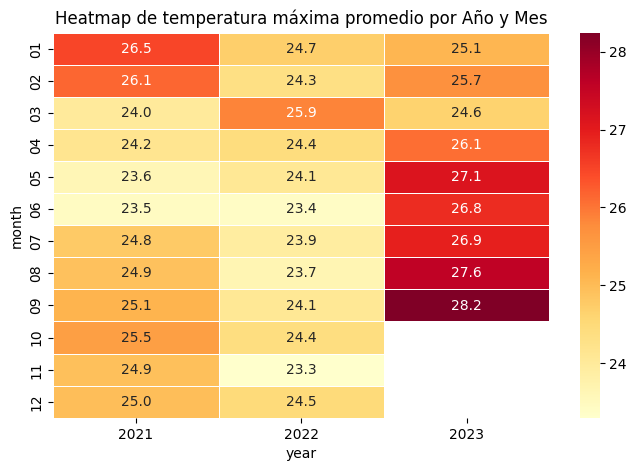

In [104]:
heatmap_data_max = df_temperatura.pivot_table(
    columns="year", index="month", values="temp_max", aggfunc="mean"
)

# Create a heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(heatmap_data_max, annot=True, fmt=".1f", cmap="YlOrRd", linewidths=0.5)
plt.title("Heatmap de temperatura máxima promedio por Año y Mes")
plt.show()

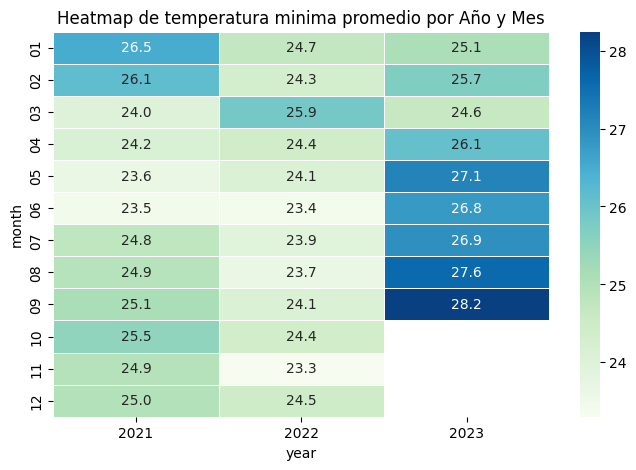

In [107]:
heatmap_data_min = df_temperatura.pivot_table(
    columns="year", index="month", values="temp_min", aggfunc="mean"
)

# Create a heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(heatmap_data_max, annot=True, fmt=".1f", cmap="GnBu", linewidths=0.5)
plt.title("Heatmap de temperatura minima promedio por Año y Mes")
plt.show()

In [110]:
df_temperatura.drop(columns=["year", "month", "Year-Month"]).to_csv(
    "processed_tables/temperatura.csv", index=False
)